In [107]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.cluster import hierarchy
from sklearn import preprocessing
import folium
import plotly.express as px


In [59]:
# Clean EPC column
def extract_epc(value):
    if isinstance(value, str) and '_' in value:
        parts = value.split('_')
        return parts[-1]
    else:
        return value
    
def map_to_numerical(column, mapping):
    return column.map(mapping)




In [60]:
import os
os.getcwd()

'/Users/sahar/becode/immo-eliza-scraping-goats/analysis'

In [74]:
# Read the CSV file into a pandas DataFrame
immo_c = pd.read_csv('../Data/cleaned/clean_set.csv')
immo_c = immo_c.drop(columns=["Unnamed: 0"], axis=1)



# How many observations and features do you have?


In [71]:
# Display the size of the Data
print("DataFrame size: ", immo_c.shape)

DataFrame size:  (85528, 31)


In [75]:
immo_c.head()

,locality,construction_year,Number_of_frontages,province,zip_code,price,property_type,subproperty_type,bedroom_count,total_area_m2,...,state_building,epc,primaryEnergyConsumptionPerSqm,heating_Type,Double_Glazing,cadastral_income,latitude,longitude,region,price_square
0,Brugge,NaN,4.0,West Flanders,8000,169000.0,0.0,HOUSE,3.0,NaN,...,NaN,2.0,508.0,GAS,1,0.0,51.214452,3.224487,Flanders,NaN
1,Brugge,1850.0,NaN,West Flanders,8000,600000.0,0.0,HOUSE,5.0,NaN,...,4.0,4.0,360.0,NaN,0,940.0,51.211312,3.220078,Flanders,NaN
2,Brugge,2021.0,NaN,West Flanders,8000,283840.0,1.0,APARTMENT,2.0,90.0,...,NaN,NaN,0.0,NaN,1,0.0,NaN,NaN,Flanders,3153.777778
3,Brugge,NaN,NaN,West Flanders,8000,395000.0,0.0,HOUSE,2.0,NaN,...,NaN,3.0,402.0,NaN,0,1405.0,51.212178,3.222933,Flanders,NaN
4,Brugge,NaN,3.0,West Flanders,8000,289000.0,0.0,HOUSE,3.0,128.0,...,NaN,2.0,686.0,NaN,0,882.0,51.212587,3.239672,Flanders,2257.812500


# What is the proportion of missing values per column?

/var/folders/gd/kk24lb6504z0vmjkdhn96kch0000gn/T/ipykernel_14193/4040643470.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')


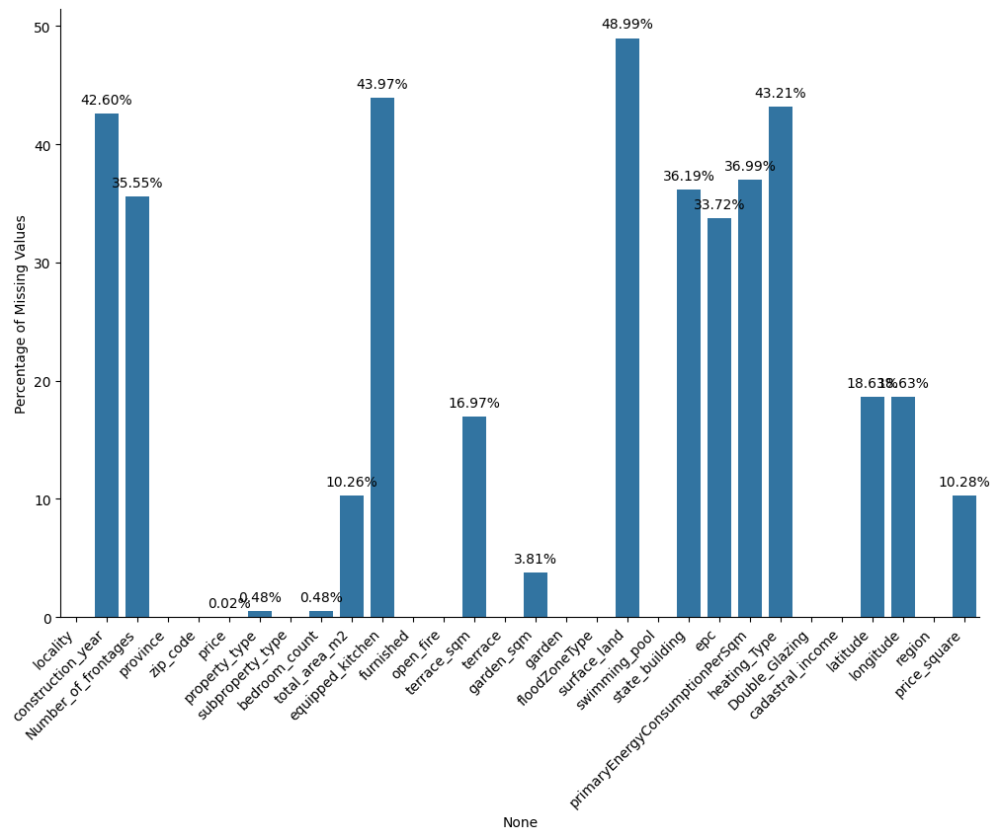

In [82]:
missing_values = immo_c.isnull().mean() * 100  # Calculate percentage of missing values


# Create a bar plot with percentages
plt.figure(figsize=(12, 8))
ax = sns.barplot(x=missing_values.index, y=missing_values.values)

# Rotate the x-axis tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

# Set y-axis label as percentage
plt.ylabel('Percentage of Missing Values')

# Show the percentage values on top of the bars for non-zero percentages
for p in ax.patches:
    if p.get_height() > 0.01:
        ax.annotate(f'{p.get_height():.2f}%', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', xytext=(0, 10), textcoords='offset points')
        

# Remove the lines on the top and right sides of the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

plt.savefig('graph/missing_values_plot.jpg', format='jpg', bbox_inches='tight')

plt.show()

In [78]:
province_missing_values

,locality,construction_year,Number_of_frontages,province,zip_code,price,property_type,subproperty_type,bedroom_count,total_area_m2,...,state_building,epc,primaryEnergyConsumptionPerSqm,heating_Type,Double_Glazing,cadastral_income,latitude,longitude,region,price_square
province,,,,,,,,,,,,,,,,,,,,,
Antwerp,0.0,33.048128,42.826585,0.0,0.0,0.030558,0.0,0.0,0.0,5.744843,...,40.488923,43.896104,45.592055,52.971734,0.0,0.030558,5.775401,5.775401,0.0,5.775401
Brussels,0.0,32.779167,26.246874,0.0,0.0,0.000000,0.0,0.0,0.0,5.002207,...,26.364573,26.114462,28.453730,35.397970,0.0,0.000000,30.572311,30.572311,0.0,5.002207
East Flanders,0.0,29.354047,56.663941,0.0,0.0,0.020442,0.0,0.0,0.0,6.152903,...,42.518397,60.384301,58.483238,63.961570,0.0,0.000000,6.909240,6.909240,0.0,6.173344
Flemish Brabant,0.0,41.382460,48.721072,0.0,0.0,0.000000,0.0,0.0,0.0,4.476248,...,40.560292,59.470158,62.758831,57.551766,0.0,0.000000,11.358100,11.358100,0.0,4.476248
Hainaut,0.0,58.027523,51.867628,0.0,0.0,0.000000,0.0,0.0,0.0,7.273919,...,50.753604,36.271298,45.773263,42.529489,0.0,0.000000,35.943644,35.943644,0.0,7.273919
Limburg,0.0,39.437428,70.436280,0.0,0.0,0.000000,0.0,0.0,0.0,8.036739,...,55.797933,57.864524,61.021814,69.747417,0.0,0.000000,4.592423,4.592423,0.0,8.036739
Liège,0.0,57.937462,51.202646,0.0,0.0,0.000000,0.0,0.0,0.0,4.960914,...,50.992183,36.349970,54.600120,39.657246,0.0,0.000000,12.327120,12.327120,0.0,4.960914
Luxembourg,0.0,55.793991,64.592275,0.0,0.0,0.000000,0.0,0.0,0.0,8.369099,...,47.317597,30.793991,41.845494,42.596567,0.0,0.000000,23.283262,23.283262,0.0,8.369099
Namur,0.0,47.322084,55.465884,0.0,0.0,0.073368,0.0,0.0,0.0,2.201027,...,43.360235,30.374175,35.803375,35.730007,0.0,0.000000,34.115921,34.115921,0.0,2.274395


/var/folders/gd/kk24lb6504z0vmjkdhn96kch0000gn/T/ipykernel_14193/371582235.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  province_missing_values = immo_c.groupby('province').apply(lambda x: x.isnull().mean() * 100)
/var/folders/gd/kk24lb6504z0vmjkdhn96kch0000gn/T/ipykernel_14193/371582235.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')


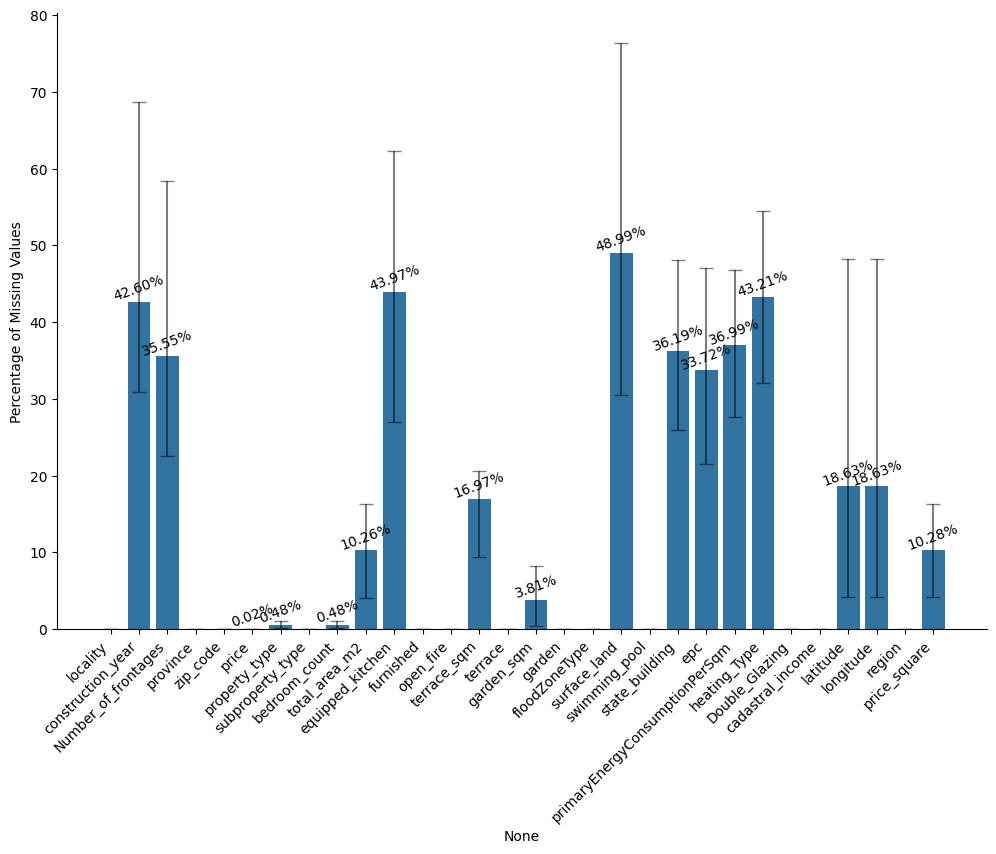

In [91]:
missing_values = immo_c.isnull().mean() * 100  # Calculate percentage of missing values

province_missing_values = immo_c.groupby('province').apply(lambda x: x.isnull().mean() * 100)

# Calculate the minimum and maximum percentage of missing values for each column and each province
min_values = province_missing_values.min().values
max_values = province_missing_values.max().values
mean_values = province_missing_values.mean()

# Ensure error bars don't extend below zero and above 100
lower_error = [max(0, val) for val in (mean_values.values - min_values)]
upper_error = [min(100, val) for val in (max_values - mean_values.values)]

# Create a bar plot with percentages
plt.figure(figsize=(12, 8))
ax = sns.barplot(x=missing_values.index, y=missing_values.values)

# Rotate the x-axis tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

# Set y-axis label as percentage
plt.ylabel('Percentage of Missing Values')

# Show the percentage values on top of the bars for non-zero percentages
for p in ax.patches:
    if p.get_height() > 0.01:
        ax.annotate(f'{p.get_height():.2f}%', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=20)

# Show error bars representing the minimum and maximum percentage of missing values across provinces
plt.errorbar(x=mean_values.index, y=mean_values.values,
             yerr=[lower_error, upper_error],
             fmt='none', color='black', capsize=5, alpha=0.5)

# Remove the lines on the top and right sides of the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Save the plot as a PDF file
plt.savefig('graph/missing_error_bars.jpg', format='jpg', bbox_inches='tight', dpi=1200)

plt.show()


# How many qualitative and quantitative variables are there? How would you transform the qualitative values into numerical values?


In [79]:
immo_c['subproperty_type'].value_counts().to_frame()


,count
subproperty_type,
APARTMENT,33118
HOUSE,32985
VILLA,3584
GROUND_FLOOR,2500
APARTMENT_BLOCK,2196
PENTHOUSE,1789
MIXED_USE_BUILDING,1701
DUPLEX,1673
FLAT_STUDIO,1339


# Which variables would you delete and why?



-public_sales & notary_ sales -> no value country, link, id

# What variables are most subject to outliers?



# What is the correlation between the variables and the price? Why do you think some variables are more correlated than others?


In [80]:
print(immo_c.dtypes)


locality                           object
construction_year                 float64
Number_of_frontages               float64
province                           object
zip_code                            int64
price                             float64
property_type                     float64
subproperty_type                   object
bedroom_count                     float64
total_area_m2                     float64
equipped_kitchen                   object
furnished                           int64
open_fire                           int64
terrace_sqm                       float64
terrace                             int64
garden_sqm                        float64
garden                              int64
floodZoneType                       int64
surface_land                      float64
swimming_pool                       int64
state_building                    float64
epc                               float64
primaryEnergyConsumptionPerSqm    float64
heating_Type                      

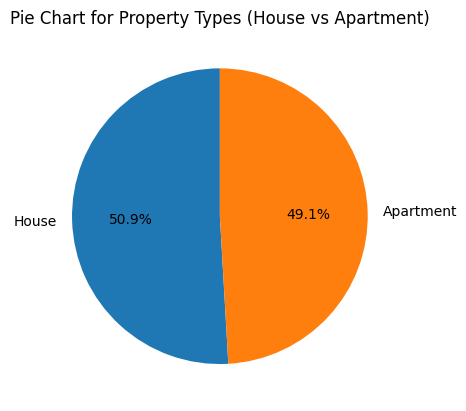

In [92]:
# Filter the DataFrame to include only 'house' and 'apartment'
filtered_data = immo_c[immo_c['property_type'].isin([0, 1])]

# Count the occurrences of each 'property_type' value
value_counts = filtered_data['property_type'].value_counts()

# Custom labels for the pie chart
labels = ['House', 'Apartment']

# Plot a pie chart with custom labels
plt.pie(value_counts, labels=labels, autopct='%1.1f%%', startangle=90)
plt.title('Pie Chart for Property Types (House vs Apartment)')

# Save the pie chart as a JPG file
plt.savefig('graph/pie_charts.jpg', bbox_inches='tight', dpi=1200)

# Show the pie chart
plt.show()

# How are the variables themselves correlated to each other? Can you find groups of variables that are correlated together?


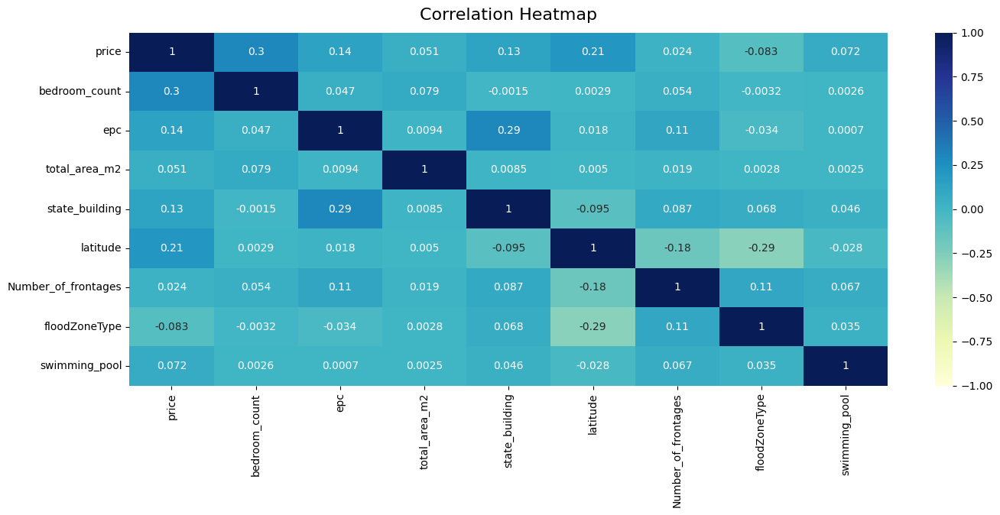

In [83]:
#remove unnecessary columns
immo_heat = immo_c[immo_c["property_type"]==1].drop(columns=["terrace_sqm"], axis=1)

# Select only numeric columns
numeric_columns = immo_heat.select_dtypes(include=['float64', 'int64'])

plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(numeric_columns[['price','bedroom_count','epc','total_area_m2','state_building','latitude','Number_of_frontages','floodZoneType',"swimming_pool"]].corr(), vmin=-1, vmax=1, annot=True, cmap="YlGnBu")
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 16}, pad=12)
plt.savefig('graph/price_heatmap.jpg', format='jpg', bbox_inches='tight')

plt.show()

In [84]:
# Select only numeric columns
numeric_columns = immo_heat.select_dtypes(include=['float64', 'int64'])

# Calculate correlation matrix
correlation_matrix = numeric_columns.corr()

# Get the top 20 highest correlation values
top_correlations = correlation_matrix.unstack().sort_values(ascending=False).drop_duplicates().head(20)

# Filter out correlations with the same column names
top_correlations = top_correlations[top_correlations.index.map(lambda x: x[0] != x[1])]

print(top_correlations)


price_square         price                0.691217
epc                  construction_year    0.352906
bedroom_count        price                0.295092
state_building       epc                  0.291474
construction_year    state_building       0.274141
epc                  zip_code             0.267123
latitude             price_square         0.266600
                     price                0.205557
longitude            floodZoneType        0.204903
furnished            price_square         0.204198
terrace              epc                  0.194365
construction_year    terrace              0.186088
terrace              state_building       0.172513
price_square         epc                  0.154160
state_building       price_square         0.150830
Number_of_frontages  construction_year    0.143348
longitude            state_building       0.143106
open_fire            Double_Glazing       0.140323
epc                  price                0.135664
dtype: float64


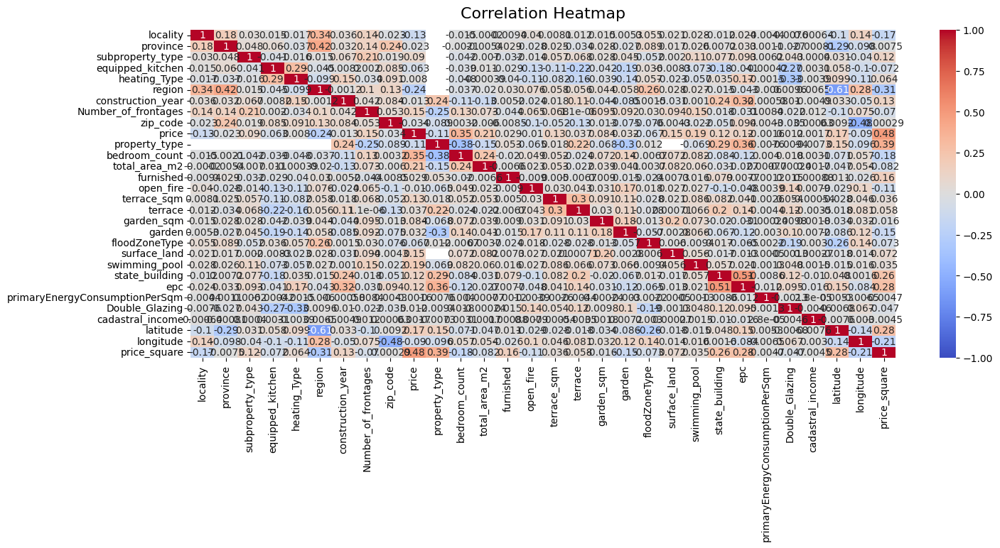

In [86]:
# Select only object-type columns
object_columns = immo_c[immo_c["property_type"]==0].select_dtypes(include=['object'])

# Convert non-numeric values to string
for column in object_columns.columns:
    object_columns[column] = object_columns[column].astype(str)

# Initialize LabelEncoder
label_encoder = preprocessing.LabelEncoder()

# Encode object-type columns
for column in object_columns.columns:
    object_columns[column] = label_encoder.fit_transform(object_columns[column])

# Combine encoded object columns with numeric columns
combined_data = pd.concat([object_columns, immo_c.select_dtypes(['float64', 'int64'])], axis=1)

# Calculate the correlation matrix
correlation_matrix = combined_data.corr()

# Create a heatmap
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(correlation_matrix, vmin=-1, vmax=1, annot=True, cmap='coolwarm')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 16}, pad=12)
plt.savefig('graph/heatmap.jpg', format='jpg', bbox_inches='tight')
plt.show()


In [87]:
# Calculate correlation matrix
combined_data = pd.concat([object_columns, immo_c[immo_c["property_type"]==0].select_dtypes(['float64', 'int64'])], axis=1)
correlation_matrix = combined_data.corr()

# Get the top 20 highest correlation values (excluding correlations with the same column names)
top_correlations = correlation_matrix.unstack().sort_values(ascending=False).drop_duplicates().head(25)
bot_correlations = correlation_matrix.unstack().sort_values(ascending=True).drop_duplicates().head(25)


# Filter out correlations with the same column names
top_correlations = top_correlations[top_correlations.index.map(lambda x: x[0] != x[1])]
bot_correlations = bot_correlations[bot_correlations.index.map(lambda x: x[0] != x[1])]

print(top_correlations)
print(bot_correlations)

price             price_square           0.630308
state_building    epc                    0.540563
province          region                 0.424769
terrace           terrace_sqm            0.377693
total_area_m2     price                  0.358940
price             bedroom_count          0.350686
region            locality               0.340028
bedroom_count     total_area_m2          0.319917
heating_Type      equipped_kitchen       0.289452
region            longitude              0.282772
garden            terrace                0.264608
region            floodZoneType          0.258881
latitude          price_square           0.257638
epc               construction_year      0.248040
province          zip_code               0.235078
state_building    price_square           0.232869
swimming_pool     price                  0.227621
price_square      epc                    0.216908
subproperty_type  Number_of_frontages    0.214562
Double_Glazing    state_building         0.208049


# What is the correlation between the variables and the price? Why do you think some variables are more correlated than others?

In [93]:
#The correlation of each column with the 'price' column
top_correlations = combined_data.corr()['price'].sort_values(ascending=False).head(10)
print(top_correlations)


price                  1.000000
price_square           0.630308
total_area_m2          0.358940
bedroom_count          0.350686
swimming_pool          0.227621
epc                    0.187682
latitude               0.185837
state_building         0.169453
Number_of_frontages    0.167598
surface_land           0.148707
Name: price, dtype: float64


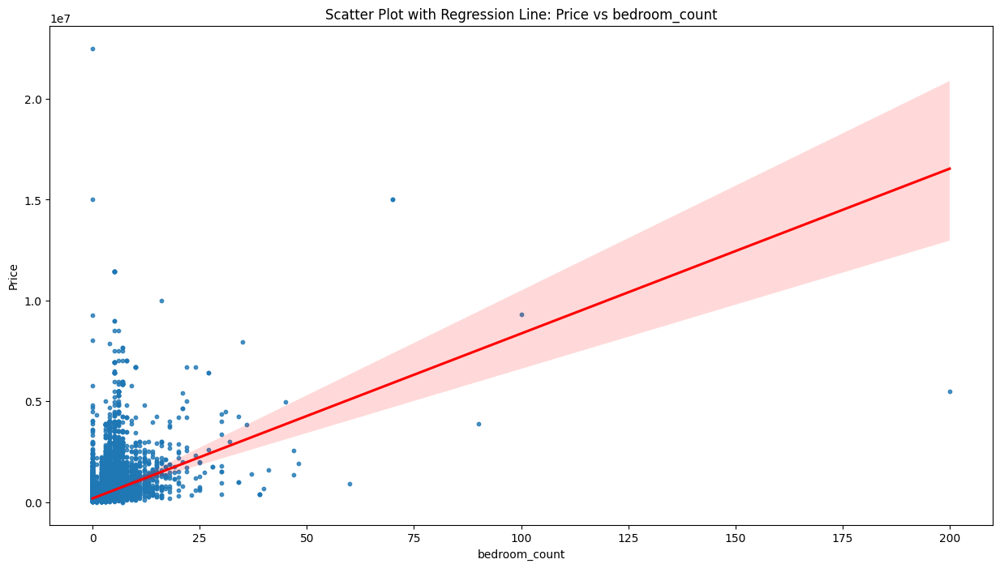

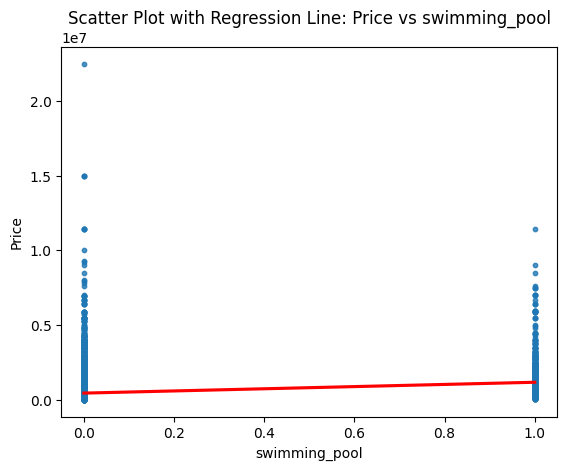

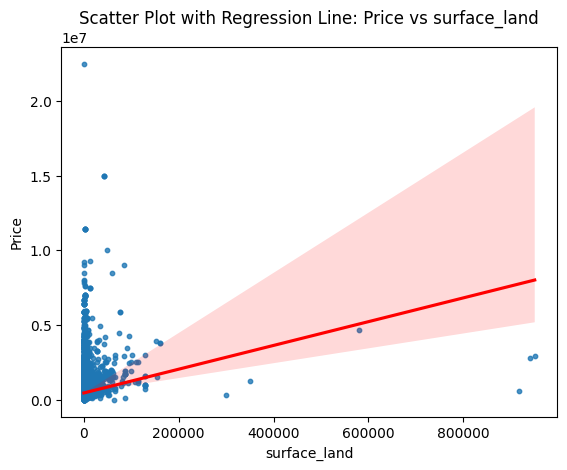

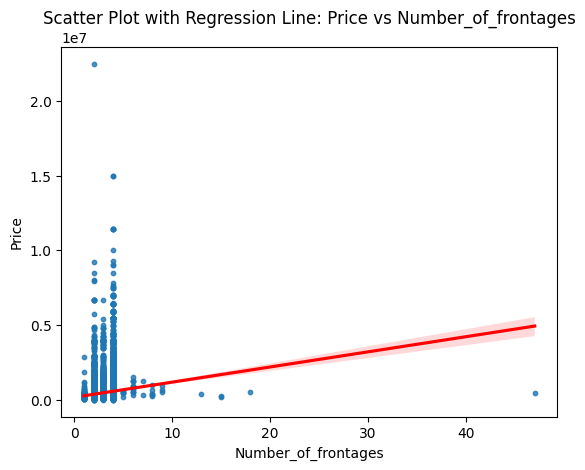

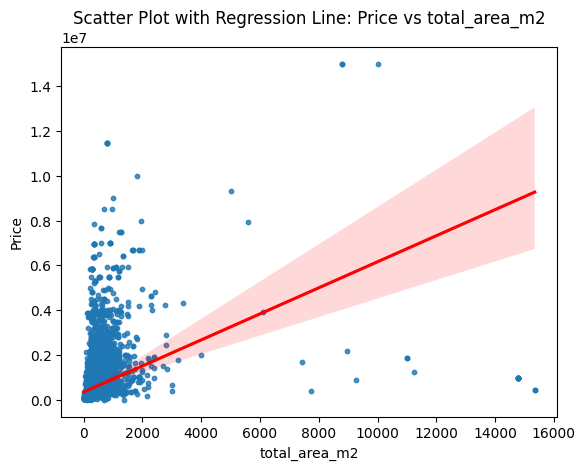

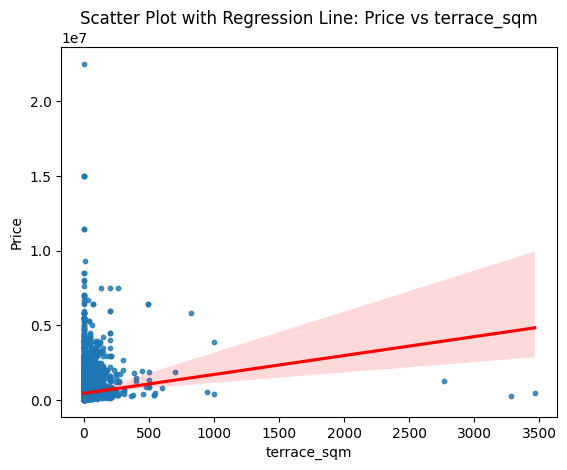

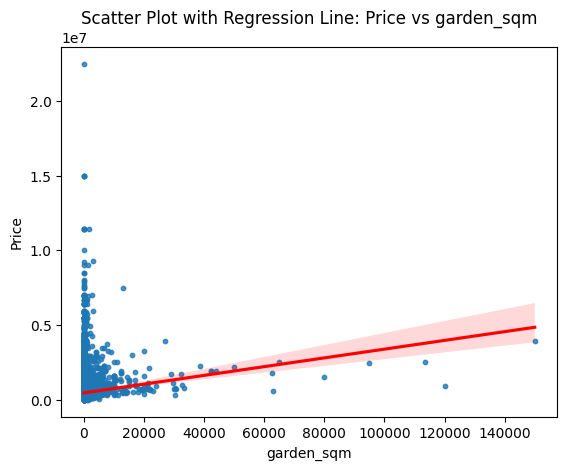

In [94]:
# Select top correlated variables with 'price'
top_variables = ['bedroom_count', 'swimming_pool', 'surface_land', 'Number_of_frontages','total_area_m2','terrace_sqm','garden_sqm']

# Create scatter plots with regression lines for each variable
plt.figure(figsize=(15, 8))
for variable in top_variables:
    sns.regplot(x=variable, y='price', data=combined_data, scatter_kws={'s': 10}, line_kws={'color': 'red'})
    plt.title(f'Scatter Plot with Regression Line: Price vs {variable}')
    plt.xlabel(variable)
    plt.ylabel('Price')
    plt.show()


# How are the number of properties distributed according to their surface?


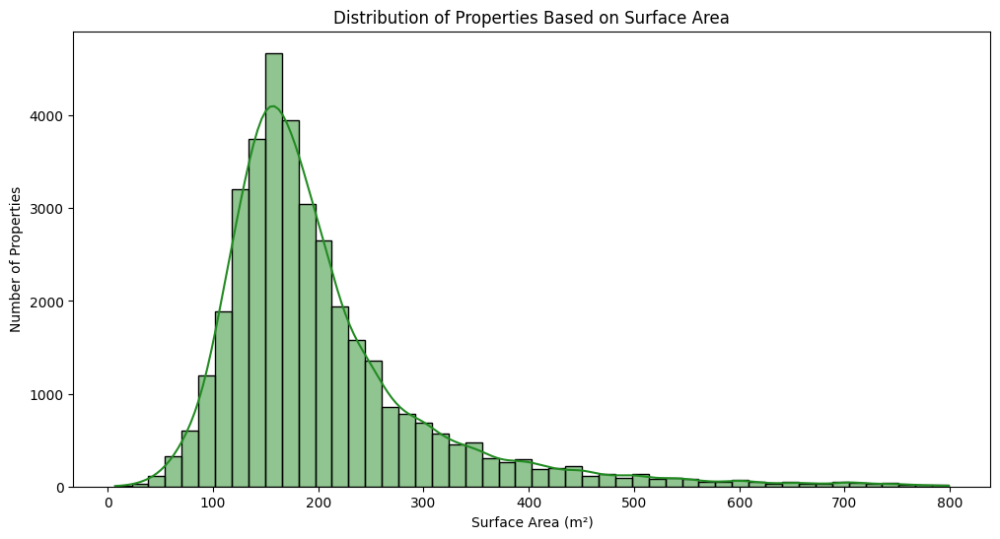

In [95]:
plt.figure(figsize=(12, 6))
sns.histplot(combined_data[combined_data['total_area_m2'] < 800]['total_area_m2'], bins=50, kde=True, color='forestgreen')
plt.title('Distribution of Properties Based on Surface Area')
plt.xlabel('Surface Area (m²)')
plt.ylabel('Number of Properties')
plt.savefig('graph/property_distribution.jpg', format='jpg', bbox_inches='tight')
plt.show()


In [96]:
# Group by property type
cleaned_sqm_prop = immo_c.groupby("property_type")


# mean price in Belgiium. 
mean_price_square = cleaned_sqm_prop["price"].mean().round().astype(int)
# median price in Belgium.
median_price_square = cleaned_sqm_prop["price"].median().round().astype(int)


In [97]:
# Consider only properties between 100k-1000k
filtered_price = immo_c[(immo_c["price"] > 100000) & (immo_c["price"] < 1000000)]


# Use groupby() to group by regions and property type. 
mean_prices = filtered_price.groupby(["region", "property_type"])["price_square"].mean().round().astype(int)
median_prices = filtered_price.groupby(["region", "property_type"])["price_square"].median().round().astype(int)


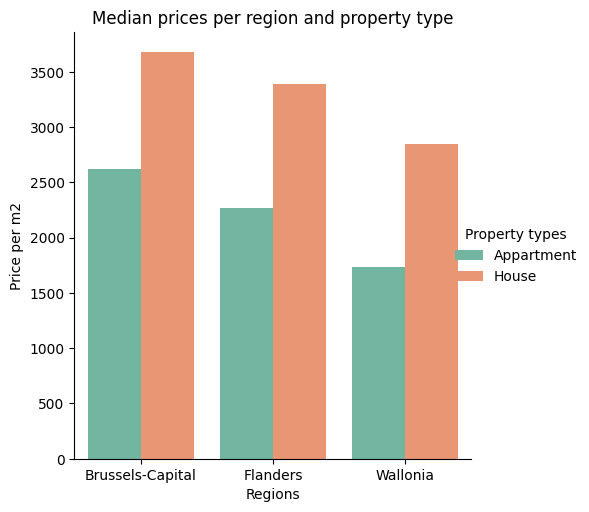

In [100]:
# Need to reset "region" & "property_type" before plotting. Groupby makes a MultiIndex(1 column has 2 variables) of both variables.
# sns takes only a regular column not a MultiIndex!
mean_prices_reset = mean_prices.reset_index()
median_prices_reset = median_prices.reset_index()

plot = sns.catplot(x="region", y="price_square", kind="bar", hue="property_type", data=median_prices_reset, palette="Set2")
plt.title("Median prices per region and property type")
plt.xlabel("Regions")
plt.ylabel("Price per m2")
legend = plot._legend
legend.set_title("Property types")
legend.texts[0].set_text("Appartment")
legend.texts[1].set_text("House")
plt.savefig('graph/Median_per_region.jpg', bbox_inches='tight', dpi=1200)
plt.show()

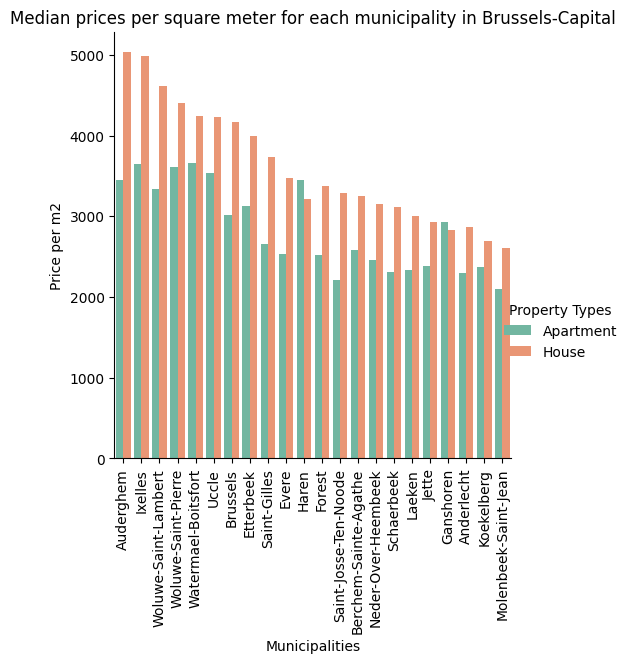

<Figure size 1100x800 with 0 Axes>

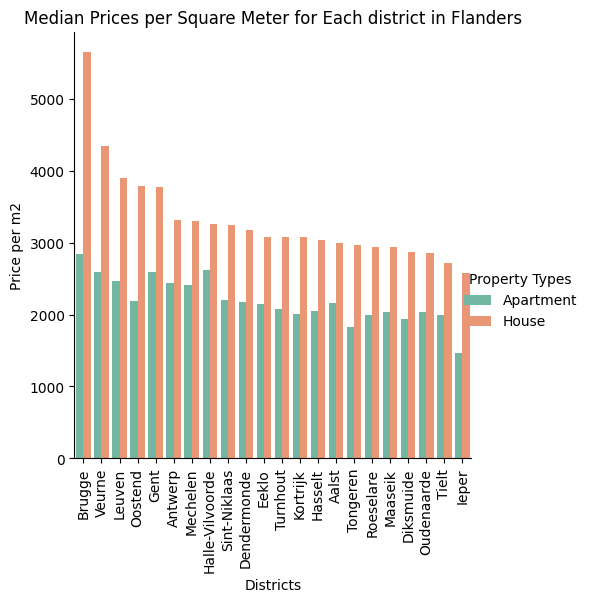

<Figure size 1100x800 with 0 Axes>

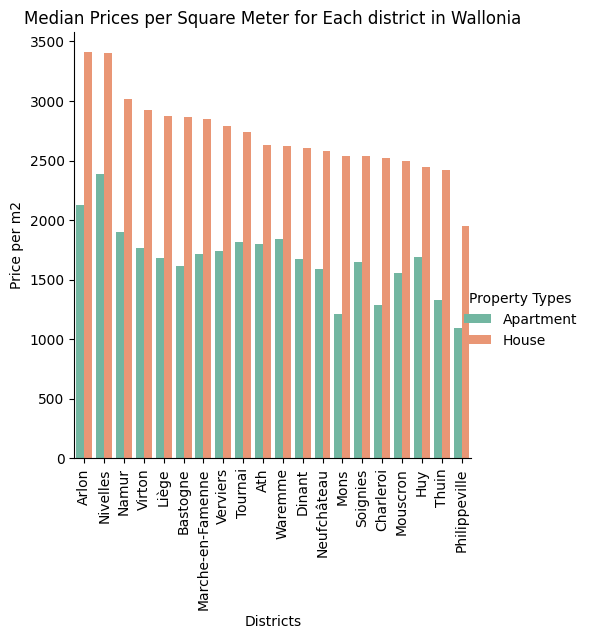

In [102]:
# Map the zip codes with their names. 
brussels_zip_codes = {
    1000: 'Brussels', 1020: 'Laeken', 1030: 'Schaerbeek', 1040: 'Etterbeek', 1050: 'Ixelles',
    1060: 'Saint-Gilles', 1070: 'Anderlecht', 1080: 'Molenbeek-Saint-Jean', 1081: 'Koekelberg', 1082: 'Berchem-Sainte-Agathe', 1083: 'Ganshoren',
    1090: 'Jette', 1120: 'Neder-Over-Heembeek', 1130: 'Haren', 1140: 'Evere', 1150: 'Woluwe-Saint-Pierre',
    1160: 'Auderghem', 1170: 'Watermael-Boitsfort', 1180: 'Uccle', 1190: 'Forest', 1200: 'Woluwe-Saint-Lambert', 1210: 'Saint-Josse-Ten-Noode'
}

# Copy of data, but only bx
brussels_houses = immo_c[immo_c['region'] == 'Brussels-Capital'].copy()

immo_c["municipalities"] = brussels_houses["zip_code"].map(brussels_zip_codes)



# Create two variables to plot the highest/lowest price per sqm in regions, reset them immediatly!
mean_prices_locality = immo_c.groupby(["region", "property_type", "locality"])["price_square"].mean().reset_index()
median_prices_locality = immo_c.groupby(["region", "property_type", "locality"])["price_square"].median().reset_index()

# Then, create the median_prices_zip_code DataFrame
median_prices_zip_code = immo_c.groupby(["region", "property_type", "zip_code", "municipalities"])["price_square"].median().reset_index()

sorted_median_zip = median_prices_zip_code.sort_values(by="price_square", ascending=False)
sorted_median_locality = median_prices_locality.sort_values(by="price_square", ascending=False)



def plot_data_median_zip(region:str):
        
    median_prices_zip_code_brussels = sorted_median_zip[sorted_median_zip["region"] == region]
    plot = sns.catplot(x="municipalities", y="price_square", hue="property_type", kind="bar", data=median_prices_zip_code_brussels, palette="Set2")
    plt.title(f"Median prices per square meter for each municipality in {region}")
    plt.ylabel("Price per m2")
    plt.xlabel("Municipalities")
    legend = plot._legend
    legend.set_title("Property Types")
    legend.texts[0].set_text("Apartment")
    legend.texts[1].set_text("House")
    plt.xticks(rotation=90)
    plt.savefig('graph/Median_per_mun_bx.jpg', bbox_inches='tight', dpi=1200)
    plt.show()
        
def plot_data_median_loc(region:str):

        median_price_region_flanders = sorted_median_locality[sorted_median_locality["region"] == region]
        plt.figure(figsize=(11, 8))
        plot = sns.catplot(x="locality", y="price_square", hue="property_type", kind="bar", data=median_price_region_flanders, palette="Set2")
        plt.title(f"Median Prices per Square Meter for Each district in {region}")
        plt.ylabel("Price per m2")
        plt.xlabel("Districts")
        legend = plot._legend
        legend.set_title("Property Types")
        legend.texts[0].set_text("Apartment")
        legend.texts[1].set_text("House")
        plt.xticks(rotation=90)
        plt.show()

plot_data_median_zip("Brussels-Capital")
plot_data_median_loc("Flanders")
plot_data_median_loc("Wallonia")

In [105]:
regions = immo_c["region"].dropna().unique()

for region in regions:
        if region != "Brussels-Capital":
            mean_price_region = mean_prices_locality[mean_prices_locality["region"] == region]
            highest_loc = mean_price_region.sort_values(by="price_square", ascending=False).head(2)
            print(f"\n{highest_loc}")
        

highest_loc_bx = median_prices_zip_code.sort_values(by="price_square", ascending=False).head(2)

# Print the localities with the highest price/sqm in each region. 
print(f"\n{highest_loc_bx}")


      region  property_type locality  price_square
26  Flanders            1.0   Brugge   7528.668059
35  Flanders            1.0   Leuven   5295.831632

      region  property_type  locality  price_square
78  Wallonia            1.0  Nivelles   3492.114367
66  Wallonia            1.0     Arlon   3325.789825

              region  property_type  zip_code municipalities  price_square
38  Brussels-Capital            1.0      1160      Auderghem   5033.653846
26  Brussels-Capital            1.0      1050        Ixelles   4980.079681


In [ ]:

brussels_data = immo_c.dropna(subset=['latitude', 'longitude'])

fig = px.scatter_mapbox(
    brussels_data,
    lat='latitude',
    lon='longitude',
    color='price',
    color_continuous_scale='blues',  # You can choose a different color scale
    hover_data=['price', 'epc', 'zip_code', 'bedroom_count'],
    size_max=60,  # You can adjust this maximum size
    mapbox_style="open-street-map",
    zoom=10,
)

fig.update_layout(mapbox_style="open-street-map")

fig.show()

In [ ]:
brussels_data = immo_c.dropna(subset=['latitude', 'longitude'])

fig = px.scatter_mapbox(
    brussels_data,
    lat='latitude',
    lon='longitude',
    color='bedroom_count',  # Color based on 'bedroom_count'
    color_continuous_scale='blues',  # You can choose a different color scale
    size='price',  # Size based on 'price'
    hover_data=['price', 'epc', 'zip_code', 'bedroom_count', 'property_type'],
    size_max=10,  # You can adjust this maximum size
    mapbox_style="open-street-map",
    zoom=10,
)

# Create a separate trace for houses
houses_data = brussels_data[brussels_data['property_type'] == 'HOUSE']
fig.add_trace(
    px.scatter_mapbox(
        houses_data,
        lat='latitude',
        lon='longitude',
        color='bedroom_count',
        size='price',
        size_max=10,
    ).data[0]
)

# Create a separate trace for apartments
apartments_data = brussels_data[brussels_data['property_type'] == 'APARTMENT']
fig.add_trace(
    px.scatter_mapbox(
        apartments_data,
        lat='latitude',
        lon='longitude',
        color='bedroom_count',
        size='price',
        size_max=10,
    ).data[0]
)

fig.update_layout(mapbox_style="open-street-map")

fig.show()


i

In [106]:
immo_c['property_type'].value_counts()

property_type
0.0    43333
1.0    41782
Name: count, dtype: int64